In [1]:
import scanpy as sc
import pandas as pd
import numpy as np

import squidpy as sq
import matplotlib.pyplot as plt
from matplotlib import rcParams

In [2]:
sc.settings.figdir = "./figures_zoom_v2/"

!mkdir figures_zoom

mkdir: cannot create directory ‘figures_zoom’: File exists


In [3]:
adata = sc.read_h5ad("h5ad/scvi/xenium5k_scVI_CellCharter_clustImmune_postQC_Tannot.h5ad")

# Format sample column
adata.obs.sample = adata.obs['sample']

# Encode missing values
adata.obs.annot[adata.obs.annot == 'nan'] = pd.NA

In [43]:
adata.obs.segmentation_method.value_counts()

segmentation_method
Segmented by interior stain (18S)                       312641
Segmented by boundary stain (ATP1A1+CD45+E-Cadherin)    103434
Segmented by nucleus expansion of 5.0µm                   6242
Name: count, dtype: int64

In [4]:
adata

AnnData object with n_obs × n_vars = 434516 × 5001
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'sample', 'graphclust', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'megagut_lvl3_predicted_labels', 'megagut_lvl3_over_clustering', 'megagut_lvl3_majority_voting', 'megagut_lvl3_conf_score', 'megagut_lvl1_predicted_labels', 'megagut_lvl1_over_clustering', 'megagut_lvl1_majority_voting', 'megagut_lvl1_conf_score', 'fibro_predicted_labels', 'fibro_over_clustering', 'fibro_majority_voting', 'fibro_conf_score', 'MF1_prob', 'MF2_prob', 'PC_prob', 'S1_prob', 'S2_prob', 'S3_prob', 'S3x_prob

In [5]:
# # Invert y axis per sample to maintain consistent (0, max) range per sample 
# for sample in adata.obs.sample.cat.categories:
#     idx = adata.obs.sample == sample
#     adata.obsm['spatial'][idx, 1] = np.max(adata.obsm['spatial'][idx, 1]) - adata.obsm['spatial'][idx, 1]  # invert y axis

In [6]:
# adata.obsm['spatial'] = adata.obsm['spatial'][:, [1, 0]]  # flip x and y coordinates

# Colors

In [7]:
del adata.uns['annot_colors']  # reset colors

/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/img/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_m

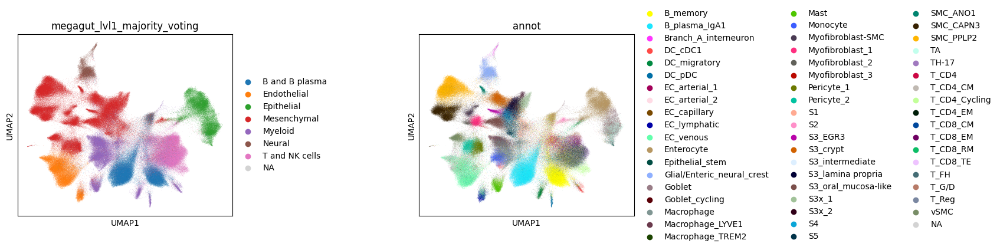

In [8]:
rcParams["figure.figsize"] = (4, 4)

sc.pl.umap(
    adata,
    color=[
        "megagut_lvl1_majority_voting", "annot"
    ],
    wspace=0.7,
    hspace=0.7,
    #palette=sc.pl.palettes.default_28
    #palette=sc.pl.palettes.default_102
    #palette=sc.pl.palettes.vega_20_scanpy
#    save="_xenium5k_celltypist_linage_confidence.pdf"
)

In [9]:
#adata.uns['annot_colors']

In [19]:
# Recolor cell types such that that they are more distinguishable on select plots
# adata.uns['annot_colors'][adata.obs.annot.cat.categories.get_loc('S3x_1')] = '#e41a1c'  # red

# adata.uns['annot_colors'][adata.obs.annot.cat.categories.get_loc('S3x_2')] = '#377eb8'  # blue
# adata.uns['annot_colors'][adata.obs.annot.cat.categories.get_loc('Mast')] = '#ff7f00'  # orange
# adata.uns['annot_colors'][adata.obs.annot.cat.categories.get_loc('Monocyte')] = '#984ea3'  # purple
# #adata.uns['annot_colors'][adata.obs.annot.cat.categories.get_loc('Treg_IL10')] = '#fdbf6f'  # light orange
# adata.uns['annot_colors'][adata.obs.annot.cat.categories.get_loc('DC_cDC1')] = '#8dd3c7'  # torquise
# #adata.uns['annot_colors'][adata.obs.annot.cat.categories.get_loc('DC_cDC2')] = '#fb8072'  # medium red
# adata.uns['annot_colors'][adata.obs.annot.cat.categories.get_loc('S5')] = '#fa217f'  # bright red /pinkish
# adata.uns['annot_colors'][adata.obs.annot.cat.categories.get_loc('S3_oral_mucosa-like')] = '#3eeaef'  # cyan
# adata.uns['annot_colors'][adata.obs.annot.cat.categories.get_loc('Myofibroblast_2')] = '#ffed6f'  # yellow

adata.uns['annot_colors'][adata.obs.annot.cat.categories.get_loc('S4')] = '#4daf4a'  # green
adata.uns['annot_colors'][adata.obs.annot.cat.categories.get_loc('T_CD8_RM')] =  '#fdbf6f'  # light orange
adata.uns['annot_colors'][adata.obs.annot.cat.categories.get_loc('T_FH')] = '#e41a1c'  # red

adata.uns['annot_colors'][adata.obs.annot.cat.categories.get_loc('T_Reg')] = '#ff7f00'  # orange
adata.uns['annot_colors'][adata.obs.annot.cat.categories.get_loc('T_CD4')] =  '#a65628'  # brown




#'#fdbf6f'  # light orange

In [20]:
# rcParams["figure.figsize"] = (4, 4)

# sc.pl.umap(
#     adata,
#     color=[
#         "megagut_lvl1_majority_voting", "annot"
#     ],
#     wspace=0.7,
#     hspace=0.7,
#     #palette=sc.pl.palettes.default_28
#     #palette=sc.pl.palettes.default_102
#     #palette=sc.pl.palettes.vega_20_scanpy
# #    save="_xenium5k_celltypist_linage_confidence.pdf"
# )

In [21]:
#adata.uns['annot_colors']

In [22]:
#cmap = 'magma_r'
#cmap = 'viridis_r'
#cmap = 'cividis_r'
#cmap = 'plasma_r'
cmap = 'inferno_r'

In [23]:
#adata.obs.annot

In [24]:
adata.obs.annot.cat.categories

Index(['B_memory', 'B_plasma_IgA1', 'Branch_A_interneuron', 'DC_cDC1',
       'DC_migratory', 'DC_pDC', 'EC_arterial_1', 'EC_arterial_2',
       'EC_capillary', 'EC_lymphatic', 'EC_venous', 'Enterocyte',
       'Epithelial_stem', 'Glial/Enteric_neural_crest', 'Goblet',
       'Goblet_cycling', 'Macrophage', 'Macrophage_LYVE1', 'Macrophage_TREM2',
       'Mast', 'Monocyte', 'Myofibroblast-SMC', 'Myofibroblast_1',
       'Myofibroblast_2', 'Myofibroblast_3', 'Pericyte_1', 'Pericyte_2', 'S1',
       'S2', 'S3_EGR3', 'S3_crypt', 'S3_intermediate', 'S3_lamina propria',
       'S3_oral_mucosa-like', 'S3x_1', 'S3x_2', 'S4', 'S5', 'SMC_ANO1',
       'SMC_CAPN3', 'SMC_PPLP2', 'TA', 'TH-17', 'T_CD4', 'T_CD4_CM',
       'T_CD4_Cycling', 'T_CD4_EM', 'T_CD8_CM', 'T_CD8_EM', 'T_CD8_RM',
       'T_CD8_TE', 'T_FH', 'T_G/D', 'T_Reg', 'vSMC'],
      dtype='object')

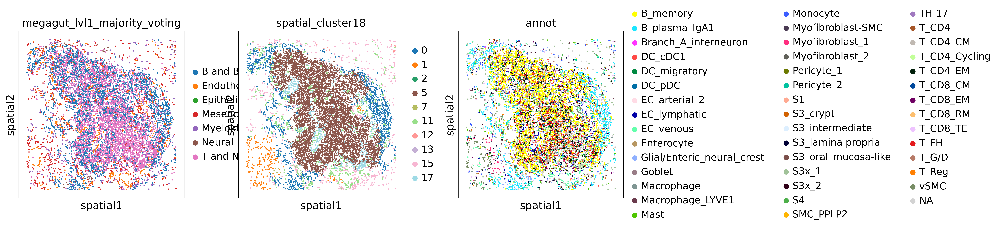

In [36]:
rcParams["figure.figsize"] = (6, 6)
sc.set_figure_params(dpi_save=300)

coord = (2300, 3940, 3150, 4800)  # x0, y0, x1, y1
sample = "0033516_affected"

sq.pl.spatial_scatter(
    adata, 
    color=[
        'megagut_lvl1_majority_voting', 'spatial_cluster18', 'annot'],
    crop_coord=coord,   # x0, y0, x1, y1
    library_key='sample', 
    img=None, 
    size=4,  # point size
    wspace=0.2,
    ncols=4,
    cmap=cmap,
    library_id=sample,
    na_color='lightgrey',
    save="lymphoid_struct_view4_" + sample + "1_v2.pdf",
    dpi=300
)

sq.pl.spatial_scatter(
    adata, 
    color=[
        'CCL19', 'CXCL13', 'MMP9', 'CXCL9', 'UBD', 'FOXP3', 'CD4', 'CD8A', 'CD19', 'annot'],
    groups=['S4',
            # B cells
            'B_plasma_IgA1', 'B_naive', 'B_memory',
            # T cells
            'TH-17',
            'T_CD4',
            'T_CD4_CM',
            'T_CD4_Cycling',
            'T_CD4_EM',
            'T_CD8_CM',
            'T_CD8_EM',
            'T_CD8_RM',
            'T_CD8_TE',
            'T_FH',
            'T_G/D',
            'T_Reg'],
    crop_coord=coord,   # x0, y0, x1, y1
    library_key='sample', 
    img=None, 
    size=3,  # point size
#    wspace=1.5,
    ncols=4,
    cmap=cmap,
    library_id=sample,
    na_color='lightgrey',
    save="lymphoid_struct_view4_" + sample + "2_v2.pdf",
    dpi=300
)

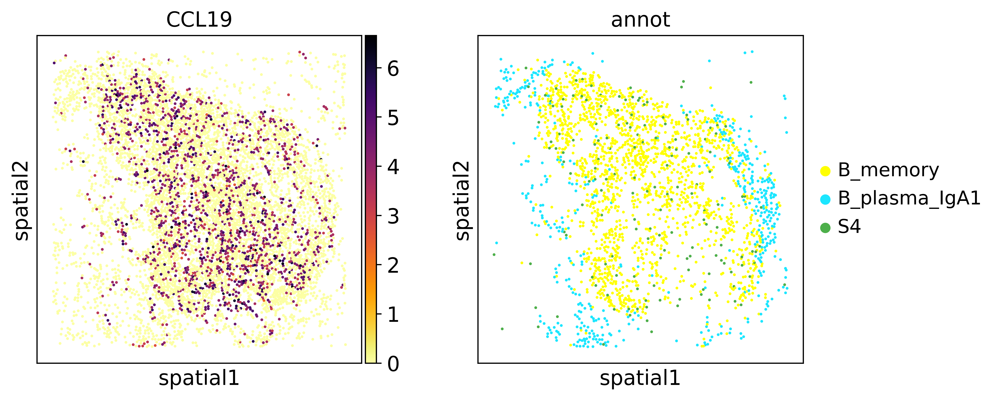

In [37]:
# Subsets of immune cells
sq.pl.spatial_scatter(
    adata, 
    color=[
        'CCL19', 'annot'],
    groups=['S4', 'B_plasma_IgA1', 'B_naive', 'B_memory'],
    crop_coord=coord,   # x0, y0, x1, y1
    library_key='sample', 
    img=None, 
    size=4,  # point size
#    wspace=1.5,
    ncols=4,
    cmap=cmap,
    library_id=sample,
    na_color='lightgrey',
    save="lymphoid_struct_view4_" + sample + "3_v2.pdf",
    dpi=300
)

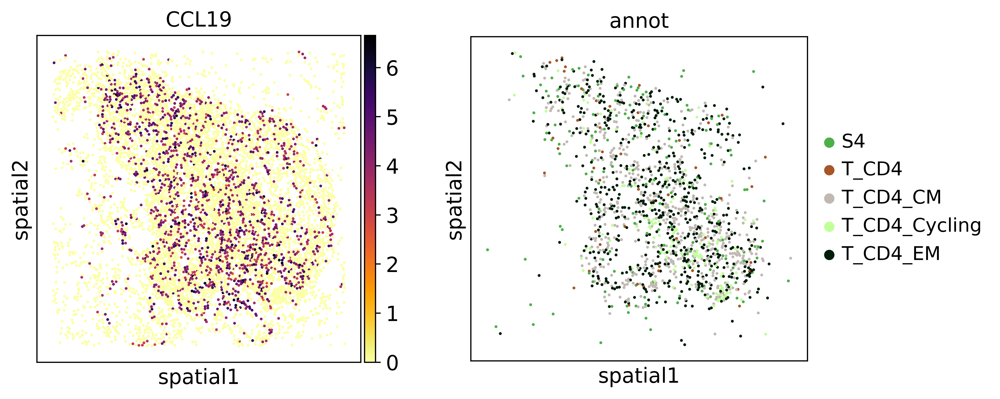

In [38]:
# Subsets of immune cells
sq.pl.spatial_scatter(
    adata, 
    color=[
        'CCL19', 'annot'],
    groups=['S4',
            'T_CD4',
            'T_CD4_CM',
            'T_CD4_Cycling',
            'T_CD4_EM',
           ],
    crop_coord=coord,   # x0, y0, x1, y1
    library_key='sample', 
    img=None, 
    size=4,  # point size
#    wspace=1.5,
    ncols=4,
    cmap=cmap,
    library_id=sample,
    na_color='lightgrey',
    save="lymphoid_struct_view4_" + sample + "4_v2.pdf",
    dpi=300
)

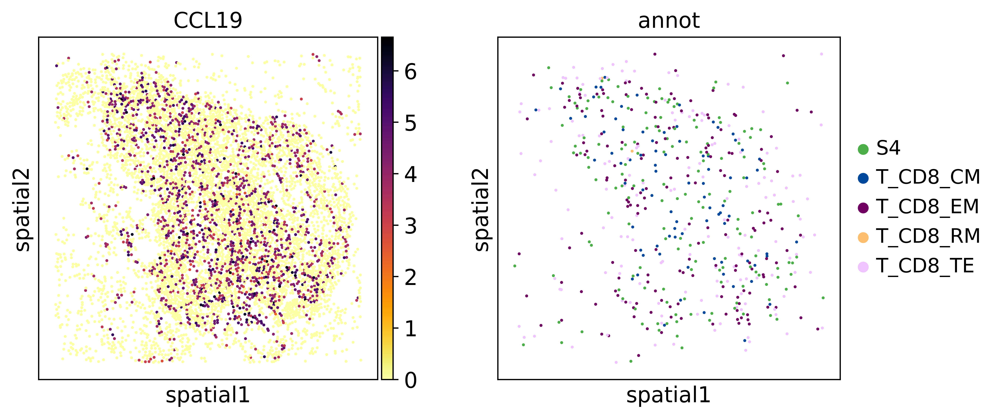

In [39]:
# Subsets of immune cells
sq.pl.spatial_scatter(
    adata, 
    color=[
        'CCL19', 'annot'],
    groups=['S4',
            'T_CD8_CM',
            'T_CD8_EM',
            'T_CD8_RM',
            'T_CD8_TE'
           ],
    crop_coord=coord,   # x0, y0, x1, y1
    library_key='sample', 
    img=None, 
    size=4,  # point size
#    wspace=1.5,
    ncols=4,
    cmap=cmap,
    library_id=sample,
    na_color='lightgrey',
    save="lymphoid_struct_view4_" + sample + "5_v2.pdf",
    dpi=300
)

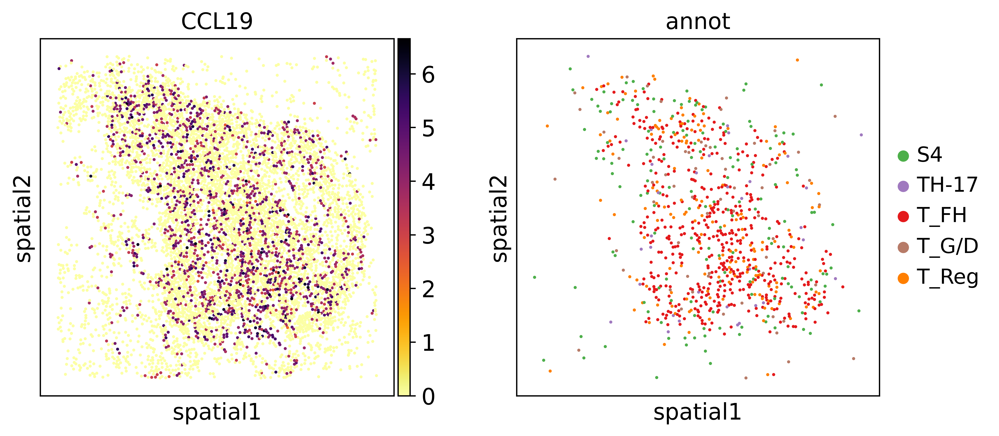

In [40]:
# Subsets of immune cells
sq.pl.spatial_scatter(
    adata, 
    color=[
        'CCL19', 'annot'],
    groups=['S4',
            'TH-17',
            'T_FH',
            'T_G/D',
            'T_Reg'
           ],
    crop_coord=coord,   # x0, y0, x1, y1
    library_key='sample', 
    img=None, 
    size=4,  # point size
#    wspace=1.5,
    ncols=4,
    cmap=cmap,
    library_id=sample,
    na_color='lightgrey',
    save="lymphoid_struct_view4_" + sample + "6_v2.pdf",
    dpi=300
)